In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch
import mpl_toolkits.mplot3d.axes3d as p3
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn import metrics, mixture, cluster, datasets
from sklearn.mixture import GaussianMixture
from sklearn.datasets import make_moons
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN
from sklearn.neighbors import kneighbors_graph
from itertools import cycle, islice
import time
from itertools import pairwise
from math import ceil

In [63]:
import warnings
warnings.filterwarnings('ignore')
sns.set_theme(context='notebook', palette='viridis')

In [64]:
pd.set_option('display.max_columns', 500)

In [65]:
df = pd.read_csv('6M-0K-99K.users.dataset.public.csv')
display(df.head(), df.describe(), df.info(), df.isnull().sum(), df.nunique())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98913 entries, 0 to 98912
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   identifierHash       98913 non-null  int64  
 1   type                 98913 non-null  object 
 2   country              98913 non-null  object 
 3   language             98913 non-null  object 
 4   socialNbFollowers    98913 non-null  int64  
 5   socialNbFollows      98913 non-null  int64  
 6   socialProductsLiked  98913 non-null  int64  
 7   productsListed       98913 non-null  int64  
 8   productsSold         98913 non-null  int64  
 9   productsPassRate     98913 non-null  float64
 10  productsWished       98913 non-null  int64  
 11  productsBought       98913 non-null  int64  
 12  gender               98913 non-null  object 
 13  civilityGenderId     98913 non-null  int64  
 14  civilityTitle        98913 non-null  object 
 15  hasAnyApp            98913 non-null 

,identifierHash,type,country,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode
0,-1097895247965112460,user,Royaume-Uni,en,147,10,77,26,174,74.0,104,1,M,1,mr,True,False,True,True,11,3196,106.53,8.88,gb
1,2347567364561867620,user,Monaco,en,167,8,2,19,170,99.0,0,0,F,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc
2,6870940546848049750,user,France,fr,137,13,60,33,163,94.0,10,3,F,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr
3,-4640272621319568052,user,Etats-Unis,en,131,10,14,122,152,92.0,7,0,F,2,mrs,True,False,True,False,12,3198,106.60,8.88,us
4,-5175830994878542658,user,Etats-Unis,en,167,8,0,25,125,100.0,0,0,F,2,mrs,False,False,False,True,22,2854,95.13,7.93,us


,identifierHash,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,civilityGenderId,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears
count,9.891300e+04,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000,98913.000000
mean,-6.692039e+15,3.432269,8.425677,4.420743,0.093304,0.121592,0.812303,1.562595,0.171929,1.773993,581.291236,3063.771870,102.125583,8.510424
std,5.330807e+18,3.882383,52.839572,181.030569,2.050144,2.126895,8.500205,25.192793,2.332266,0.428679,208.855888,168.298621,5.609735,0.467863
min,-9.223101e+18,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,11.000000,2852.000000,95.070000,7.920000
25%,-4.622895e+18,3.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,572.000000,2857.000000,95.230000,7.940000
50%,-1.337989e+15,3.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,694.000000,3196.000000,106.530000,8.880000
75%,4.616388e+18,3.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,702.000000,3201.000000,106.700000,8.890000
max,9.223331e+18,744.000000,13764.000000,51671.000000,244.000000,174.000000,100.000000,2635.000000,405.000000,3.000000,709.000000,3205.000000,106.830000,8.900000


None

identifierHash         0
type                   0
country                0
language               0
socialNbFollowers      0
socialNbFollows        0
socialProductsLiked    0
productsListed         0
productsSold           0
productsPassRate       0
productsWished         0
productsBought         0
gender                 0
civilityGenderId       0
civilityTitle          0
hasAnyApp              0
hasAndroidApp          0
hasIosApp              0
hasProfilePicture      0
daysSinceLastLogin     0
seniority              0
seniorityAsMonths      0
seniorityAsYears       0
countryCode            0
dtype: int64

identifierHash         98913
type                       1
country                  200
language                   5
socialNbFollowers         90
socialNbFollows           85
socialProductsLiked      420
productsListed            65
productsSold              75
productsPassRate          72
productsWished           279
productsBought            70
gender                     2
civilityGenderId           3
civilityTitle              3
hasAnyApp                  2
hasAndroidApp              2
hasIosApp                  2
hasProfilePicture          2
daysSinceLastLogin       699
seniority                 19
seniorityAsMonths         19
seniorityAsYears           6
countryCode              199
dtype: int64

In [66]:
df.shape

(98913, 24)

In [67]:
df.columns

Index(['identifierHash', 'type', 'country', 'language', 'socialNbFollowers',
       'socialNbFollows', 'socialProductsLiked', 'productsListed',
       'productsSold', 'productsPassRate', 'productsWished', 'productsBought',
       'gender', 'civilityGenderId', 'civilityTitle', 'hasAnyApp',
       'hasAndroidApp', 'hasIosApp', 'hasProfilePicture', 'daysSinceLastLogin',
       'seniority', 'seniorityAsMonths', 'seniorityAsYears', 'countryCode'],
      dtype='object')

In [68]:
df.drop(['identifierHash'], axis=1, inplace=True)

In [69]:
# check for duplicates
df.duplicated().sum()

49153

In [70]:
df.drop_duplicates(inplace=True)

In [71]:
df.shape

(49760, 23)

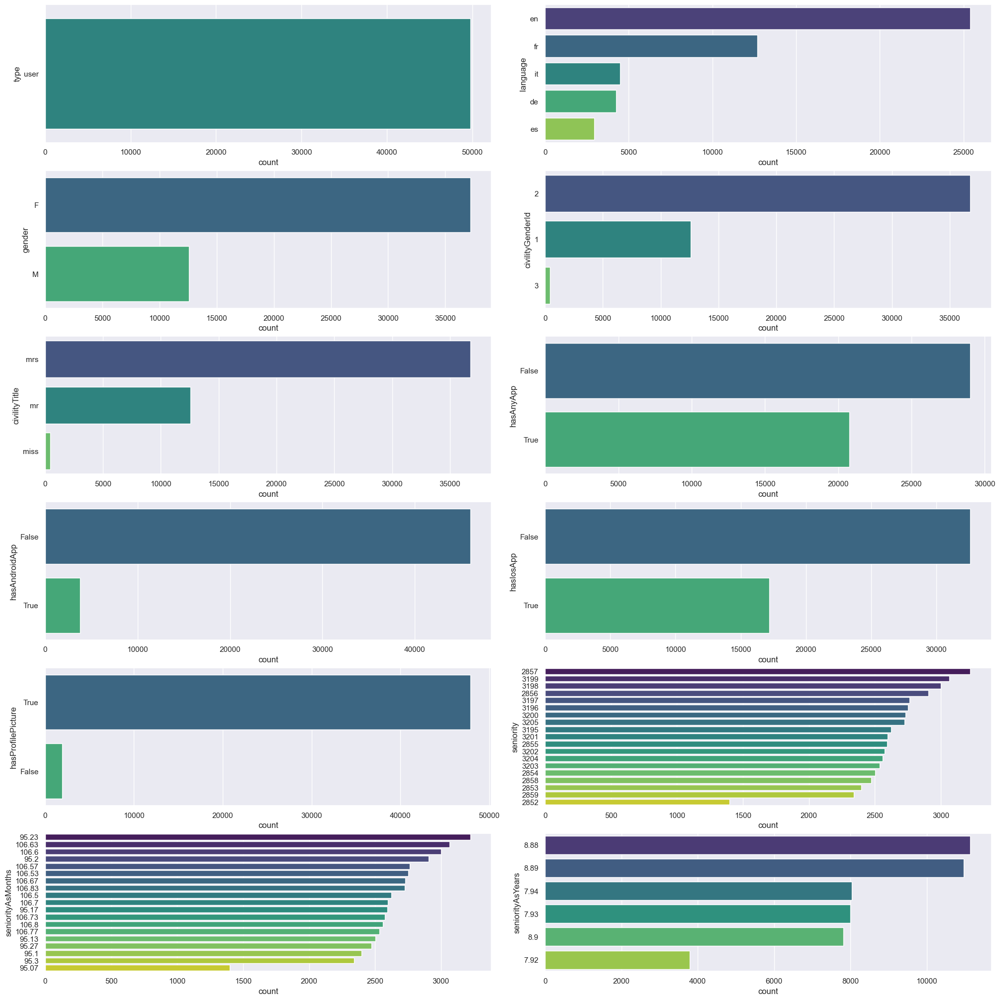

In [72]:
fig, axs = plt.subplots(6, 2, figsize=(20, 20), constrained_layout=True)
categorical = ['type', 'language', 'gender',
               'civilityGenderId', 'civilityTitle', 'hasAnyApp', 'hasAndroidApp',
               'hasIosApp', 'hasProfilePicture', 'seniority',
               'seniorityAsMonths', 'seniorityAsYears', ]
for i, f in enumerate(categorical):
    sns.countplot(y=f, data=df,
                  ax=axs[i//2][i % 2],
                  order=df[f].value_counts().index, palette='viridis')

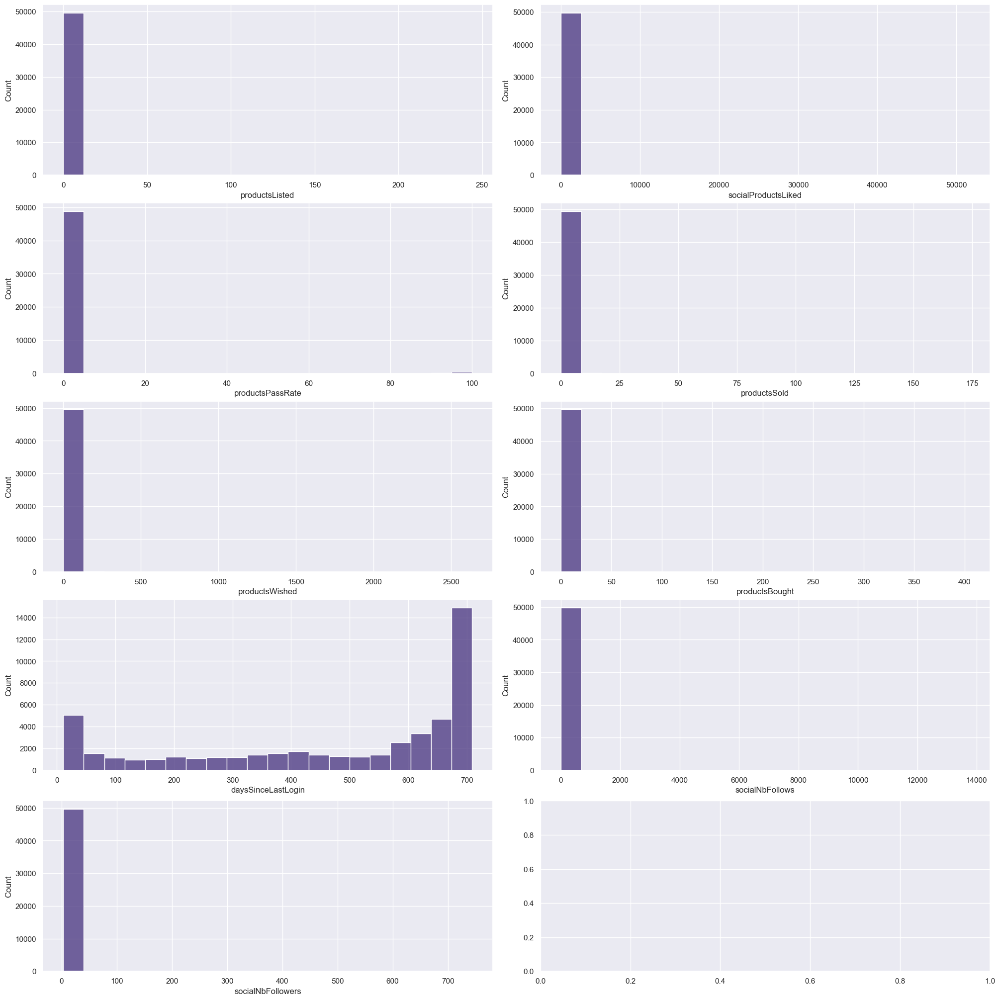

In [73]:
numerical = set(df.columns)-set(categorical)-{'countryCode', 'country'}
fig, axs = plt.subplots(len(numerical)//2+1, 2,
                        figsize=(20, 20), constrained_layout=True)

for i, f in enumerate(numerical):
    sns.histplot(x=f, data=df,
                 ax=axs[i//2][i % 2], bins=20,
                 palette=sns.color_palette("viridis", 2))

plt.show()

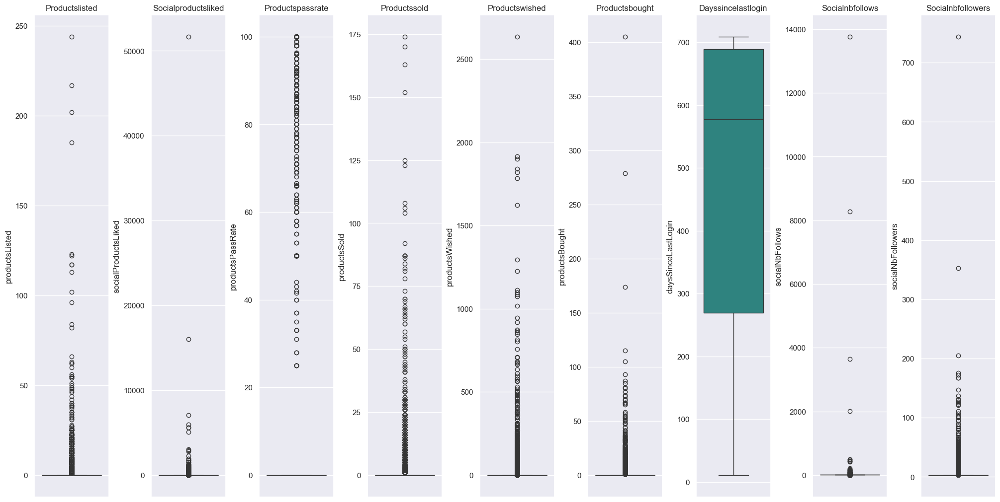

In [74]:
fig, axs = plt.subplots(1, 9,
                        figsize=(20, 10), constrained_layout=True)
for i, f in enumerate(numerical):
    sns.boxplot(y=f,  data=df,  ax=axs[i],
                palette="viridis")
    axs[i].set_title(f.capitalize())


plt.show()

In [75]:
numerical

{'daysSinceLastLogin',
 'productsBought',
 'productsListed',
 'productsPassRate',
 'productsSold',
 'productsWished',
 'socialNbFollowers',
 'socialNbFollows',
 'socialProductsLiked'}

In [76]:
def diskretization(df,column, val1, val2):
    conditions = [
        (df[column] <= val1),
        (df[column] > val1) & (df[column] < val2),
        (df[column] >= val2)
    ]

    values = [0, 1, 2]
    df[column] = np.select(conditions, values, default=0)

In [77]:
diskretization(df,'socialProductsLiked', 0, 5)
diskretization(df,'socialNbFollows', 0, 10)
diskretization(df,'socialNbFollowers', 0, 5)
diskretization(df,'productsBought', 0, 5)
diskretization(df,'productsWished', 0, 5)
diskretization(df,'productsSold', 0, 5)
diskretization(df,'productsListed', 0, 3)
diskretization(df,'productsPassRate', 0, 80)

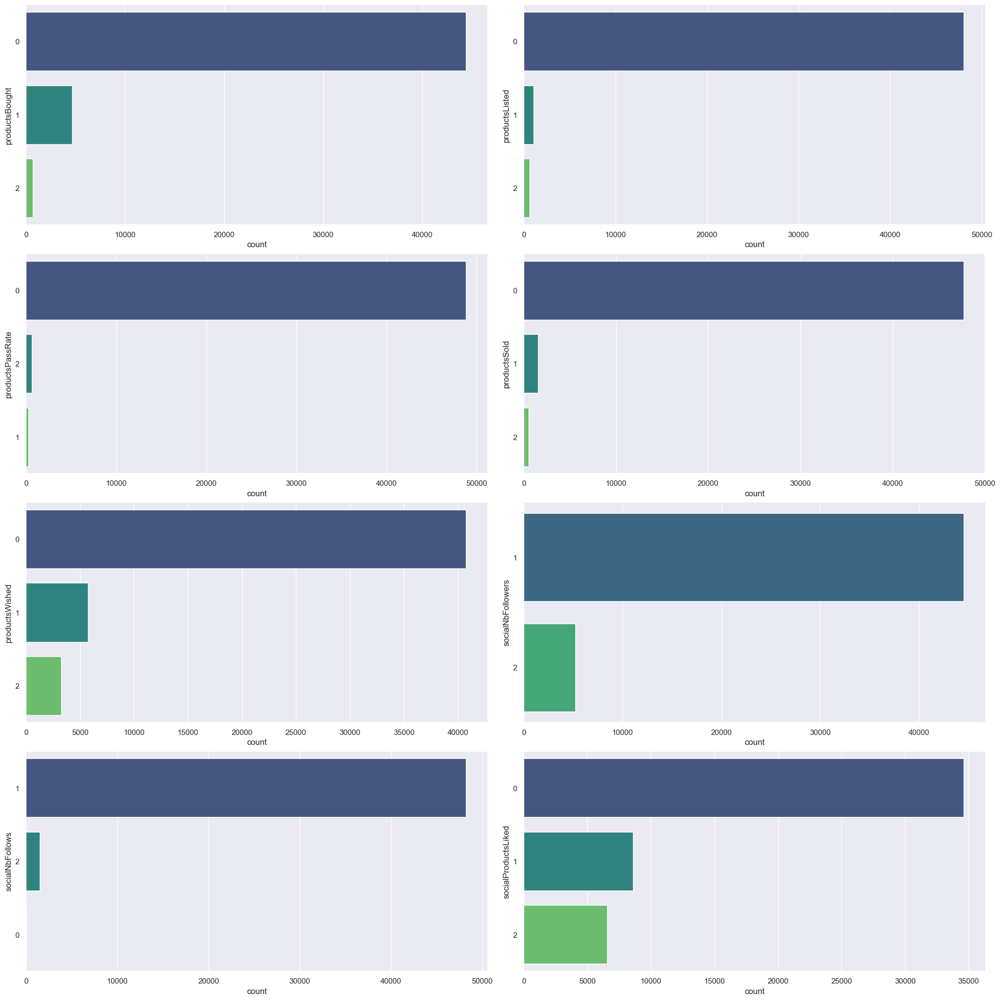

In [78]:
fig, axs = plt.subplots(4, 2, figsize=(20, 20), constrained_layout=True)
cols = ['productsBought', 'productsListed', 'productsPassRate',
        'productsSold', 'productsWished', 'socialNbFollowers', 'socialNbFollows', 'socialProductsLiked']
for i, f in enumerate(cols):
    sns.countplot(y=f, data=df,
                  ax=axs[i//2][i % 2],
                  order=df[f].value_counts().index, palette='viridis')

In [79]:
df.head()

,type,country,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode
0,user,Royaume-Uni,en,2,2,2,2,2,1,2,1,M,1,mr,True,False,True,True,11,3196,106.53,8.88,gb
1,user,Monaco,en,2,1,1,2,2,2,0,0,F,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc
2,user,France,fr,2,2,2,2,2,2,2,1,F,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr
3,user,Etats-Unis,en,2,2,2,2,2,2,2,0,F,2,mrs,True,False,True,False,12,3198,106.60,8.88,us
4,user,Etats-Unis,en,2,1,0,2,2,2,0,0,F,2,mrs,False,False,False,True,22,2854,95.13,7.93,us


In [80]:
df.drop(['type'], axis=1, inplace=True)

In [81]:
df.head()

,country,language,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,civilityTitle,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,countryCode
0,Royaume-Uni,en,2,2,2,2,2,1,2,1,M,1,mr,True,False,True,True,11,3196,106.53,8.88,gb
1,Monaco,en,2,1,1,2,2,2,0,0,F,2,mrs,True,False,True,True,12,3204,106.80,8.90,mc
2,France,fr,2,2,2,2,2,2,2,1,F,2,mrs,True,False,True,False,11,3203,106.77,8.90,fr
3,Etats-Unis,en,2,2,2,2,2,2,2,0,F,2,mrs,True,False,True,False,12,3198,106.60,8.88,us
4,Etats-Unis,en,2,1,0,2,2,2,0,0,F,2,mrs,False,False,False,True,22,2854,95.13,7.93,us


In [82]:
# encode categorical
df["gender"] = df["gender"].map({'M': 0, 'F': 1})

In [83]:
country_count = dict(df['countryCode'].value_counts())
df['countryCode'] = df['countryCode'].map(country_count)

In [84]:
country_count = dict(df['country'].value_counts())
df['country'] = df['country'].map(country_count)

In [85]:
df = pd.get_dummies(df, columns=['language', 'civilityTitle'])

In [86]:
df_with_country_codes = df.copy()
df.drop(['countryCode'], axis=1, inplace=True)
df.head()

,country,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,civilityGenderId,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,seniorityAsMonths,seniorityAsYears,language_de,language_en,language_es,language_fr,language_it,civilityTitle_miss,civilityTitle_mr,civilityTitle_mrs
0,5454,2,2,2,2,2,1,2,1,0,1,True,False,True,True,11,3196,106.53,8.88,False,True,False,False,False,False,True,False
1,34,2,1,1,2,2,2,0,0,1,2,True,False,True,True,12,3204,106.80,8.90,False,True,False,False,False,False,False,True
2,11145,2,2,2,2,2,2,2,1,1,2,True,False,True,False,11,3203,106.77,8.90,False,False,False,True,False,False,False,True
3,7459,2,2,2,2,2,2,2,0,1,2,True,False,True,False,12,3198,106.60,8.88,False,True,False,False,False,False,False,True
4,7459,2,1,0,2,2,2,0,0,1,2,False,False,False,True,22,2854,95.13,7.93,False,True,False,False,False,False,False,True


<Axes: >

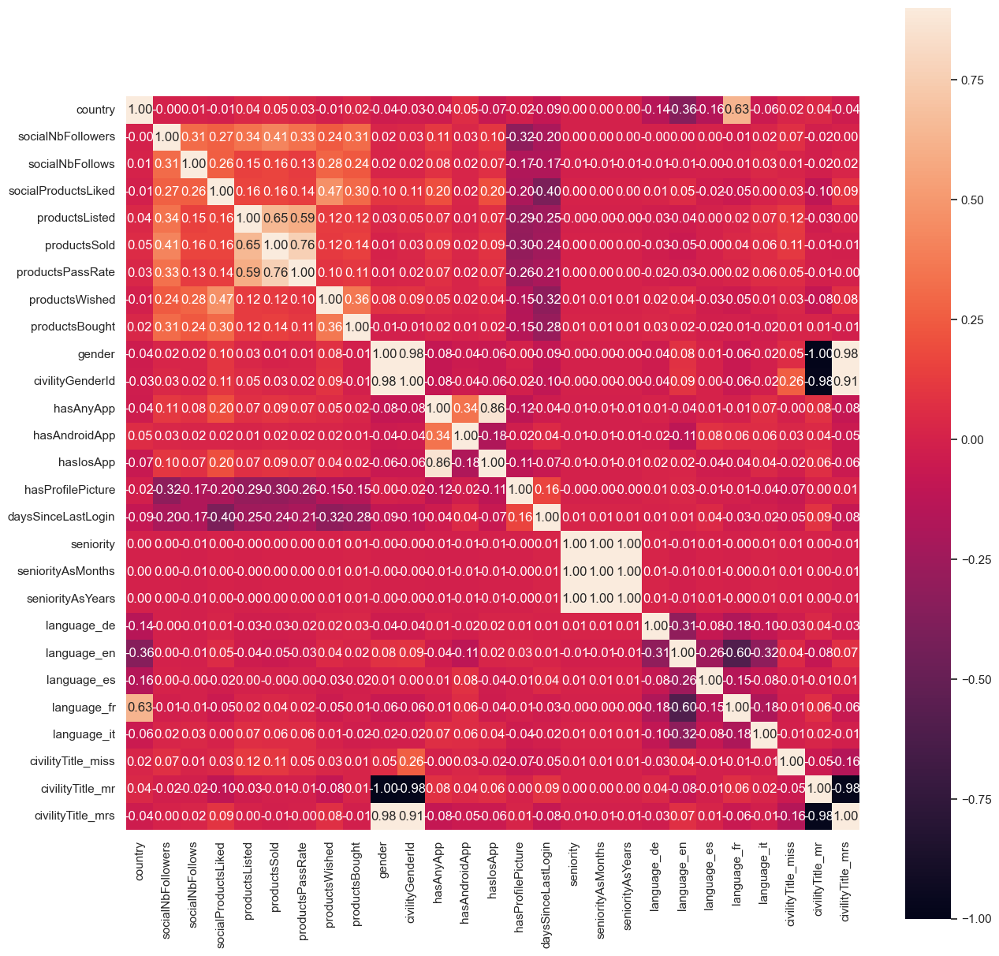

In [87]:
corr_matrix = df.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix,  vmax=.9, square=True,
            annot=True, fmt='.2f')

In [88]:
# drop highly correlated features
df.drop(['civilityTitle_miss', 'civilityTitle_mr', 'civilityTitle_mrs', 'civilityGenderId',
         'seniorityAsMonths', 'seniorityAsYears'], axis=1, inplace=True)

<Axes: >

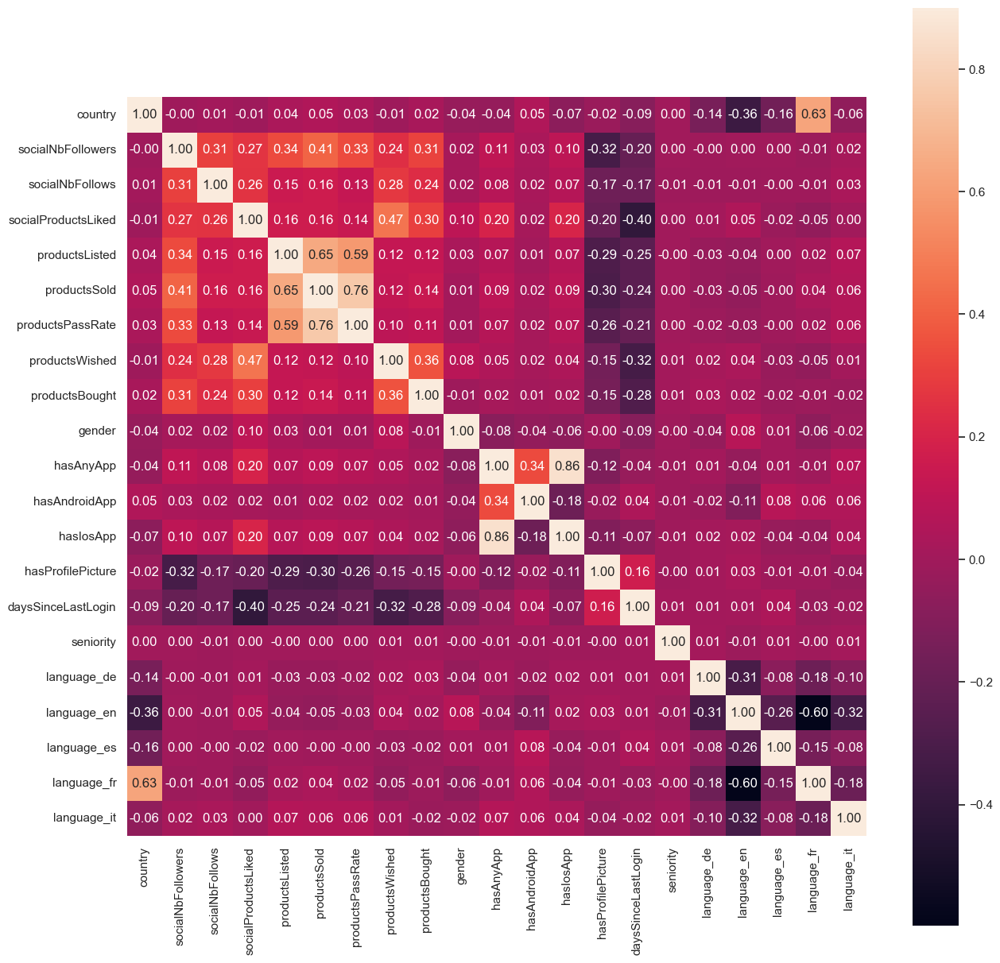

In [89]:
corr_matrix = df.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix,  vmax=.9, square=True,
            annot=True, fmt='.2f')

In [90]:
scaler = MinMaxScaler((-1, 1))
df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

df.describe()

,country,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,language_de,language_en,language_es,language_fr,language_it
count,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000,49760.000000
mean,-0.051850,-0.789912,0.029260,-0.563666,-0.952532,-0.948714,-0.967805,-0.753477,-0.878798,0.494695,-0.165555,-0.848834,-0.309807,0.924156,0.306102,0.193923,-0.828859,0.020740,-0.881551,-0.489952,-0.820378
std,0.700701,0.613227,0.173125,0.714047,0.266194,0.263433,0.240849,0.562836,0.366892,0.869076,0.986211,0.528664,0.950809,0.382019,0.698404,0.954915,0.559464,0.999795,0.472093,0.871758,0.571828
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,-0.770818,-1.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-0.260745,-0.971671,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,-0.169598,-1.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000,1.000000,0.624642,0.949008,-1.000000,1.000000,-1.000000,-1.000000,-1.000000
75%,0.338478,-1.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,1.000000,-1.000000,1.000000,1.000000,0.942693,0.977337,-1.000000,1.000000,-1.000000,1.000000,-1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [91]:
# from sklearn.neighbors import LocalOutlierFactor

# clf = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
# y_pred = clf.fit_predict(df)
# df = df[y_pred == 1]

# df.shape

In [92]:
from sklearn.ensemble import IsolationForest

clf = IsolationForest(contamination=0.03)
y_pred = clf.fit_predict(df)
df = df[y_pred == 1]

df.shape

(48267, 21)

In [93]:
df.head()

,country,socialNbFollowers,socialNbFollows,socialProductsLiked,productsListed,productsSold,productsPassRate,productsWished,productsBought,gender,hasAnyApp,hasAndroidApp,hasIosApp,hasProfilePicture,daysSinceLastLogin,seniority,language_de,language_en,language_es,language_fr,language_it
11,0.338478,1.0,0.0,-1.0,-1.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,-0.836676,-0.983003,-1.0,1.0,-1.0,-1.0,-1.0
117,1.000000,1.0,0.0,-1.0,0.0,1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,1.0,0.426934,-0.960340,-1.0,-1.0,-1.0,1.0,-1.0
130,-0.812276,1.0,0.0,-1.0,0.0,1.0,0.0,-1.0,-1.0,1.0,1.0,-1.0,1.0,1.0,0.292264,0.954674,-1.0,-1.0,-1.0,1.0,-1.0
147,1.000000,1.0,0.0,-1.0,-1.0,1.0,0.0,-1.0,-1.0,-1.0,1.0,-1.0,1.0,1.0,-0.991404,-0.971671,-1.0,-1.0,-1.0,1.0,-1.0
187,0.338478,1.0,0.0,-1.0,-1.0,1.0,1.0,-1.0,-1.0,1.0,1.0,-1.0,1.0,1.0,-0.570201,0.943343,-1.0,1.0,-1.0,-1.0,-1.0


In [94]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px


def plot_3d(X_pca, labels, title='3D PCA Cluster Plot'):
    fig = px.scatter_3d(x=X_pca[:, 0], y=X_pca[:, 1], z=X_pca[:, 2], color=labels,
                        labels={'x': 'PCA 0',
                                'y': 'PCA 1', 'z': 'PCA 2'},
                        title=title)
    fig.update_traces(marker=dict(size=3))
    fig.show()

In [95]:
def plot_2d(X_pca, clusters):
    plt.figure(figsize=(20, 5))
    plots_components = [(0, 1), (0, 2), (0, 3), (0, 4)]

    for i, (x, y) in enumerate(plots_components):
        plt.subplot(1, 4, i+1)
        plt.scatter(X_pca[:, x], X_pca[:, y], c=clusters,
                    cmap='viridis', s=50)
        plt.title(f'Original Data with True Clusters {x} vs {y}')
        plt.xlabel(f'Principal Component {x}')
        plt.ylabel(f'Principal Component {y}')
    plt.show()

In [96]:
def plot_feature_importance(df, clusters, centroids=None):
    if centroids is None:
        centroids = df.groupby(clusters).mean()

    feature_importance = centroids.std(axis=0)
    plt.figure(figsize=(10, 5))
    plt.bar(df.columns, feature_importance)
    plt.xticks(rotation=90)
    plt.title('Feature importance based on centroids')
    plt.show()

    return feature_importance

In [97]:
def analyze_features(df, feature_importance, clusters, num_clusters, thershold=0.25):
    important_columns = df.columns[feature_importance > thershold]
    cluster_data = np.array(
        [df[clusters == i][important_columns].mean(axis=0) for i in range(num_clusters)])
    cluster_data = pd.DataFrame(
        cluster_data.T, columns=range(num_clusters), index=important_columns)

    return cluster_data

2 3 4 5 6 7 8 9 10 11 

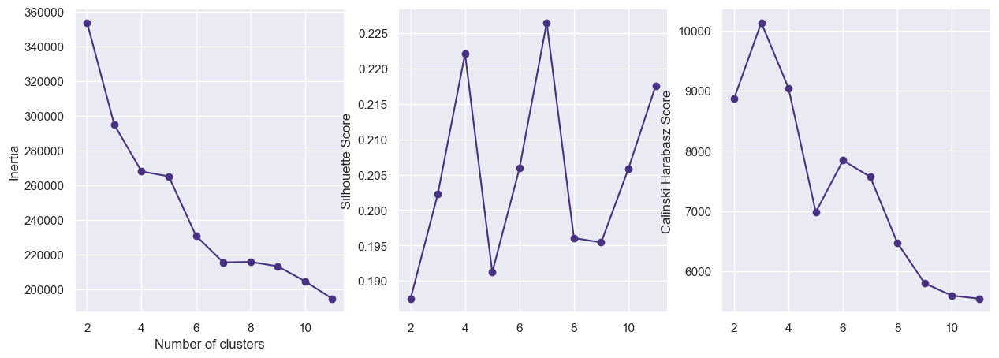

In [98]:
k_range = range(2, 12)
inertia = []
silhouette = []
calinski = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df)
    inertia.append(kmeans.inertia_)
    silhouette.append(metrics.silhouette_score(
        df, kmeans.labels_, sample_size=10000))
    calinski.append(metrics.calinski_harabasz_score(df, kmeans.labels_))
    print(k, end=' ')

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.subplot(1, 3, 2)
plt.plot(k_range, silhouette, marker='o')
plt.ylabel('Silhouette Score')
plt.subplot(1, 3, 3)
plt.plot(k_range, calinski, marker='o')
plt.ylabel('Calinski Harabasz Score')
plt.show()

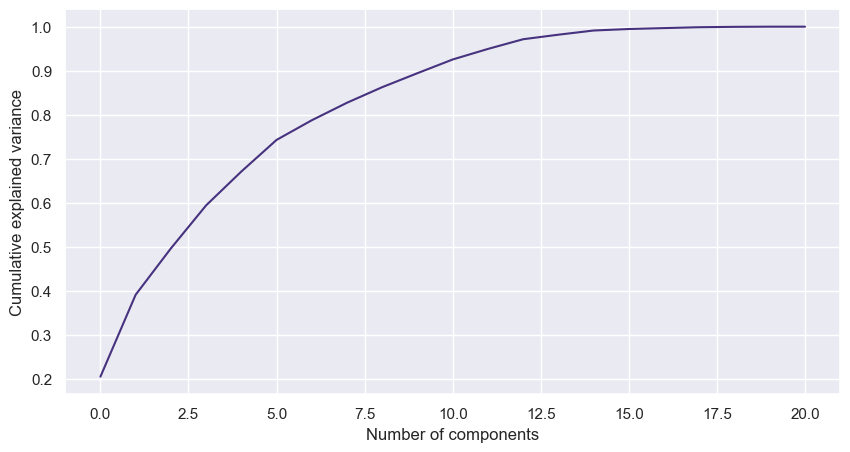

In [99]:
# apply pca
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(df)
data_pca = pca.transform(df)

# plot pca
plt.figure(figsize=(10, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()

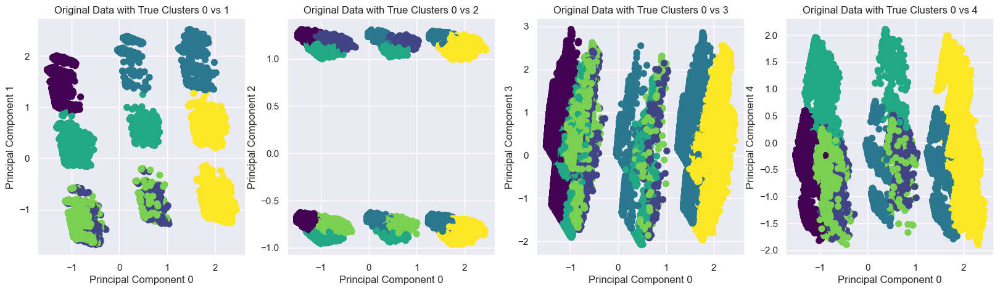

In [100]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(df)

# Apply KMeans clustering
NUM_CLUSTERS = 6
kmeans = KMeans(n_clusters=NUM_CLUSTERS, random_state=42)
clusters = kmeans.fit_predict(df)

plot_2d(X_pca, clusters)
plot_3d(X_pca, clusters)

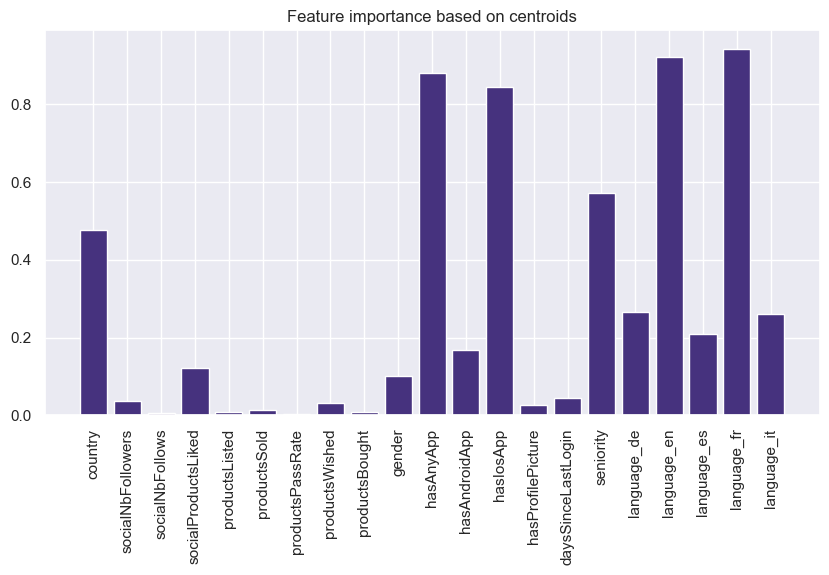

,0,1,2,3,4,5
country,0.658436,-0.256894,0.744108,-0.331590,-0.234926,-0.380747
hasAnyApp,-1.000000,-0.867284,1.000000,-0.692776,-0.878450,1.000000
hasIosApp,-1.000000,-1.000000,0.530864,-1.000000,-1.000000,1.000000
seniority,0.190554,-0.979334,0.184552,0.229644,0.971218,0.188669
language_de,-1.000000,-1.000000,-1.000000,-0.279269,-1.000000,-0.759835
language_en,-1.000000,1.000000,-1.000000,-1.000000,1.000000,0.383613
language_fr,1.000000,-1.000000,1.000000,-1.000000,-1.000000,-1.000000
language_it,-1.000000,-1.000000,-1.000000,-0.295599,-1.000000,-0.744417


In [101]:
feature_importance =\
    plot_feature_importance(df, clusters, centroids=kmeans.cluster_centers_)
analyze_features(df, feature_importance, clusters, NUM_CLUSTERS)

In [102]:
nonimportant_columns =df.columns[feature_importance < 0.25]
df_features = df.drop(columns=nonimportant_columns)

2 3 4 5 6 7 8 9 10 11 

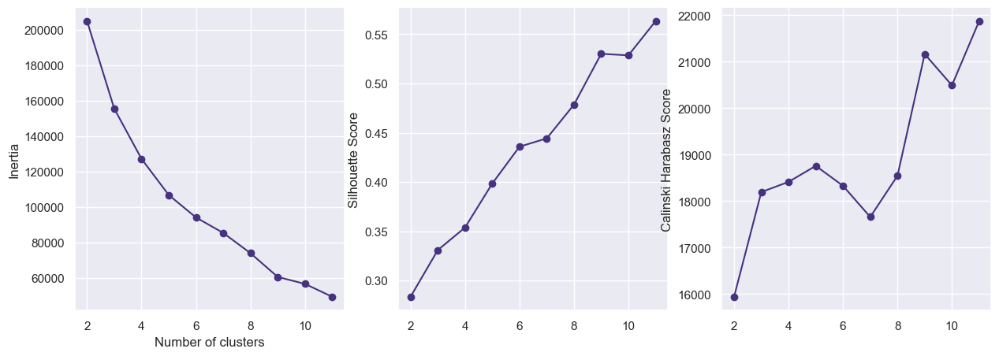

In [103]:
k_range = range(2, 12)
inertia = []
silhouette = []
calinski = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_features)
    inertia.append(kmeans.inertia_)
    silhouette.append(metrics.silhouette_score(
        df_features, kmeans.labels_, sample_size=10000))
    calinski.append(metrics.calinski_harabasz_score(df_features, kmeans.labels_))
    print(k, end=' ')

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.subplot(1, 3, 2)
plt.plot(k_range, silhouette, marker='o')
plt.ylabel('Silhouette Score')
plt.subplot(1, 3, 3)
plt.plot(k_range, calinski, marker='o')
plt.ylabel('Calinski Harabasz Score')
plt.show()

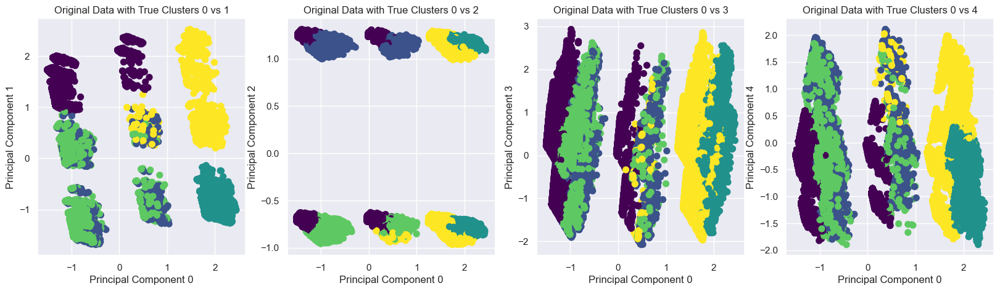

In [104]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(df)

# Apply KMeans clustering
NUM_CLUSTERS = 5
kmeans = KMeans(n_clusters=NUM_CLUSTERS, random_state=42)
clusters = kmeans.fit_predict(df_features)

plot_2d(X_pca, clusters)
plot_3d(X_pca, clusters)

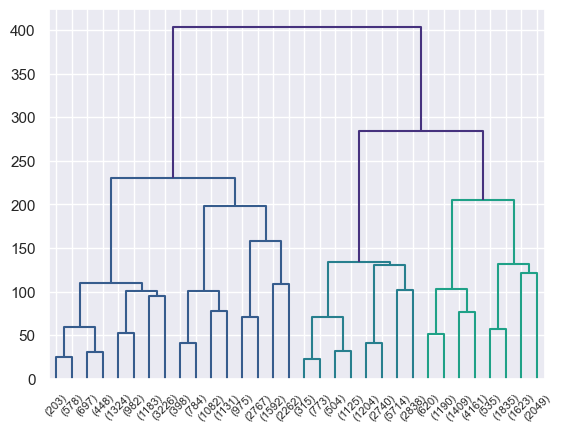

In [105]:
X = df.values
linkage_matrix = sch.linkage(X, method='ward')

dendrogram = sch.dendrogram(linkage_matrix, truncate_mode='level', p=4)

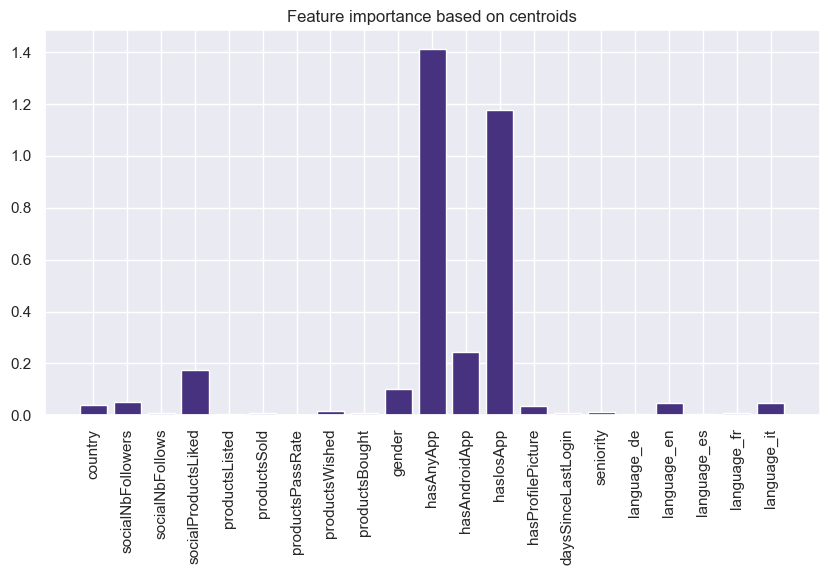

,0,1
hasAnyApp,1.000000,-0.998603
hasIosApp,0.665444,-0.998813


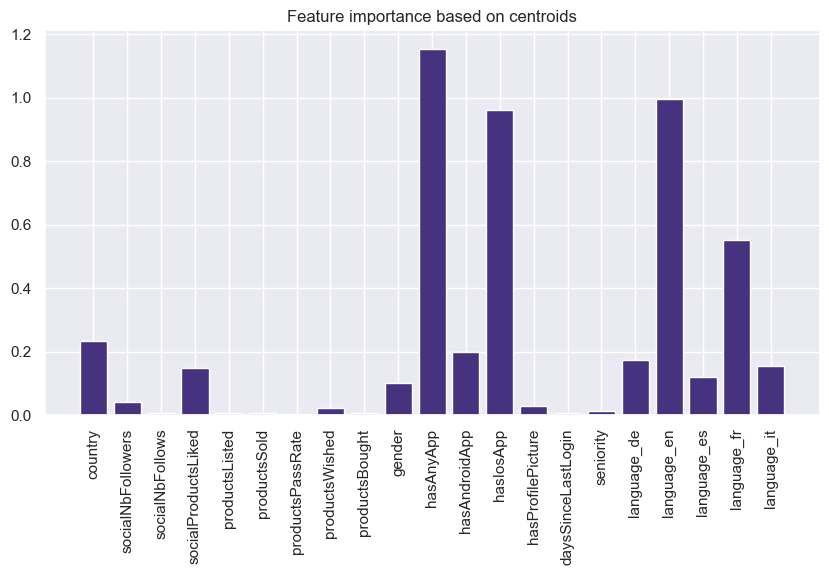

,0,1,2
hasAnyApp,1.000000,-1.000000,-0.997020
hasIosApp,0.665444,-1.000000,-0.997467
language_en,-0.009474,0.989877,-0.999851
language_fr,-0.498370,-1.000000,0.099538


In [106]:
for cut_height in [350, 250]:
    clusters = sch.fcluster(linkage_matrix, cut_height, criterion='distance')
    plot_3d(X_pca, clusters, f'Cut height: {cut_height}')
    fi = plot_feature_importance(df, clusters-1)
    display(analyze_features(df, fi, clusters-1, clusters.max()))

2 3 4 5 6 7 8 9 10 11 

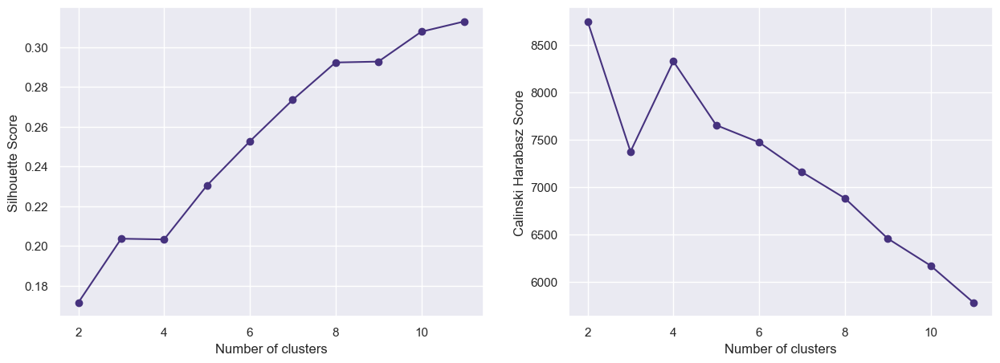

In [107]:
from sklearn.cluster import Birch

silhouette = []


calinski = []


for k in range(2, 12):


    birch = Birch(n_clusters=k)


    birch_labels = birch.fit_predict(df)


    silhouette.append(metrics.silhouette_score(


        df, birch_labels, sample_size=5000))


    calinski.append(metrics.calinski_harabasz_score(df, birch_labels))


    print(k, end=' ')



plt.figure(figsize=(15, 5))


plt.subplot(1, 2, 1)


plt.plot(range(2, 12), silhouette, marker='o')


plt.xlabel('Number of clusters')


plt.ylabel('Silhouette Score')


plt.subplot(1, 2, 2)


plt.plot(range(2, 12), calinski, marker='o')


plt.xlabel('Number of clusters')


plt.ylabel('Calinski Harabasz Score')


plt.show()

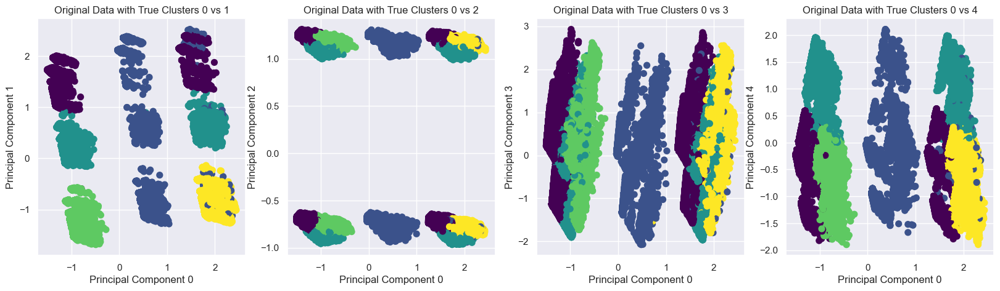

In [108]:
birch = Birch(n_clusters=5)
birch_labels = birch.fit_predict(df)
plot_2d(X_pca, birch_labels)
plot_3d(X_pca, birch_labels)

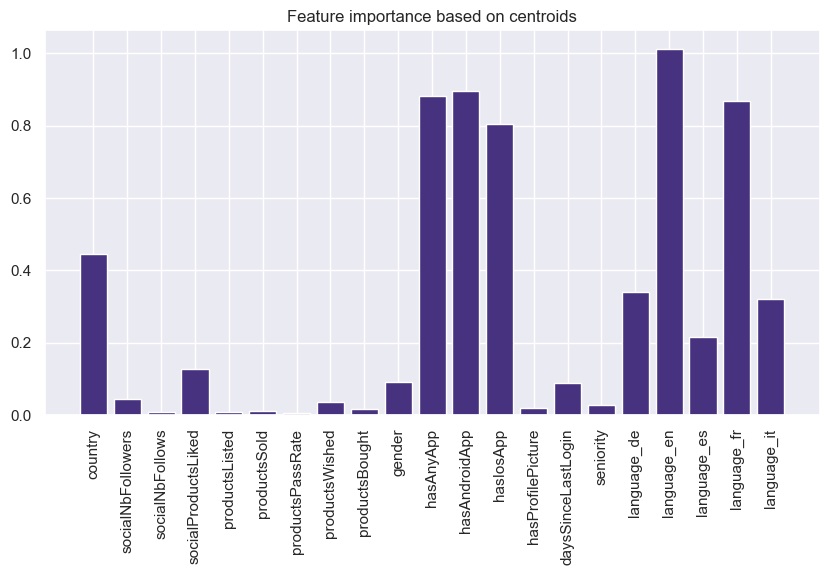

,0,1,2,3
country,0.681949,0.089821,-0.331012,-0.246162
hasAnyApp,-0.325435,1.000000,-0.226266,-1.000000
hasAndroidApp,-1.000000,1.000000,-0.997794,-1.000000
hasIosApp,-0.325435,-0.935122,-0.227268,-1.000000
language_de,-1.000000,-0.870245,-0.219048,-1.000000
language_en,-0.996051,-0.363610,-1.000000,1.000000
language_fr,0.996051,-0.302271,-1.000000,-1.000000
language_it,-1.000000,-0.721026,-0.262155,-1.000000


In [109]:
fi = plot_feature_importance(df, birch_labels)
analyze_features(df, fi, birch_labels, 4)

In [110]:
nonimportant_columns =df.columns[feature_importance < 0.25]
df_features = df.drop(columns=nonimportant_columns)

2 3 4 5 6 7 8 9 10 11 

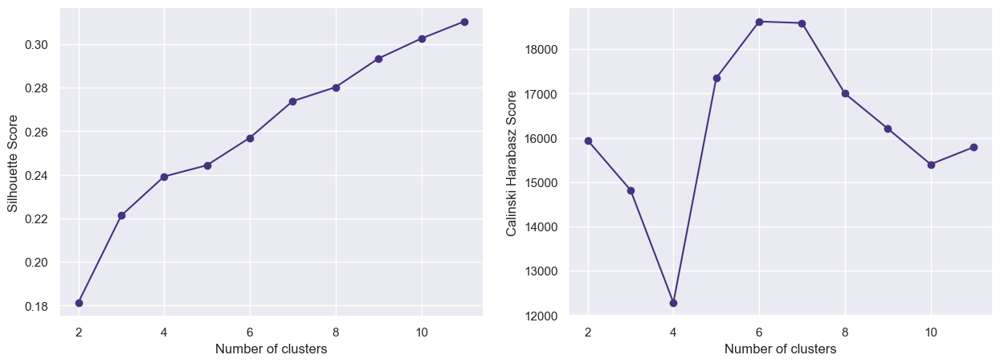

In [111]:
from sklearn.cluster import Birch

silhouette = []


calinski = []


for k in range(2, 12):


    birch = Birch(n_clusters=k)


    birch_labels = birch.fit_predict(df_features)


    silhouette.append(metrics.silhouette_score(


        df, birch_labels, sample_size=5000))


    calinski.append(metrics.calinski_harabasz_score(df_features, birch_labels))


    print(k, end=' ')



plt.figure(figsize=(15, 5))


plt.subplot(1, 2, 1)


plt.plot(range(2, 12), silhouette, marker='o')


plt.xlabel('Number of clusters')


plt.ylabel('Silhouette Score')


plt.subplot(1, 2, 2)


plt.plot(range(2, 12), calinski, marker='o')


plt.xlabel('Number of clusters')


plt.ylabel('Calinski Harabasz Score')


plt.show()

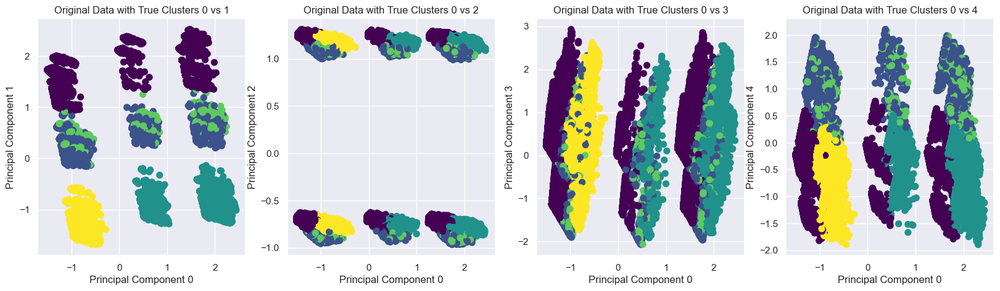

In [112]:
birch = Birch(n_clusters=5)
birch_labels = birch.fit_predict(df_features)
plot_2d(X_pca, birch_labels)
plot_3d(X_pca, birch_labels)